In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np
from sklearn.cluster import AgglomerativeClustering
from core.cluster_validation import get_linkage_matrix
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, fcluster

In [2]:
# region_id = 5883 # freiburtg
region_id = 69333 # prague

In [3]:

etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/chars/tessellations_chars_{region_id}.parquet')
tess = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/chars/tessellations_chars_{region_id}.parquet')
buildings = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/chars/buildings_chars_{region_id}.parquet')
streets = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/chars/streets_chars_{region_id}.parquet')
nodes = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/chars/nodes_chars_{region_id}.parquet')
primary = pd.read_parquet(f'/data/uscuni-ulce/processed_data/chars/primary_chars_{region_id}.parquet')

In [4]:
model_params = '_75_0_None_None_False'

In [5]:
# streets.explore()

In [6]:
def morphotopes_to_etcs(region_id, etcs=True, model_params='_100_0_None_None_False'):


    if etcs:
        etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/tessellations/tessellation_{region_id}.parquet')

    else:
        etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/buildings/buildings_{region_id}.parquet')
        
    etcs['label'] = -1
    
    morphotopes = pd.read_parquet(f'/data/uscuni-ulce/processed_data/morphotopes/tessellation_labels_morphotopes_{region_id}{model_params}.pq')
    morphotopes.loc[:, 'morphotope_label'] =  morphotopes.values[:, 0]

    morph_dict = pd.Series(np.arange(np.unique(morphotopes.values).shape[0]),
                       np.unique(morphotopes.values))
    etcs.loc[morphotopes.index, 'label'] = morphotopes.map(lambda x: morph_dict.loc[x]).values
    etcs['morph'] = str(region_id) + '_' + '-1'
    etcs.loc[morphotopes.index, 'morph'] = str(region_id) + '_' + morphotopes.values
    return etcs

In [7]:
etcs = morphotopes_to_etcs(region_id, model_params=model_params)

In [8]:
primary['morph'] = etcs['morph']

In [9]:
%%time
morph_chars = primary.groupby('morph').agg('mean')

CPU times: user 61.9 ms, sys: 622 μs, total: 62.5 ms
Wall time: 62.1 ms


In [10]:
morphotopes = morph_chars[morph_chars.index.str.split('_').str[-1] != '-1']

In [121]:
## increase similarity between 48 and 43, 
## increase similarity  644 and 661
## decrease between 48,43 and 644, 661

In [151]:
selected_morphotopes = ['69333_849_48', '69333_849_43',
                        '69333_849_643', 
                        '69333_849_647',  '69333_849_655', '69333_849_653', '69333_849_661', '69333_849_266',   '69333_849_640',
                        '69333_849_83', 
                        
                        ]
labels = ['malesavice_industrial', 'uhrineves_industrial',
           'train_station_offices', 
          'strizkov_blocks',  'chodov_blocks', 'kobilisy_blocks', 'haje_blocks', 'repy_blocks',  'nakosiku_blocks',
          'vinohrady_victorian' 
          ]

In [152]:
to_drop = ['stcSAl','stbOri','stcOri','stbCeA', 
           'ldkAre', 'ldkPer', 'lskCCo', 'lskERI',
           'lskCWA', 'ltkOri', 'ltkWNB', 'likWBB', 'likWCe',
          # 'licBAD', 'mibLAL', 'mibAre', 'mibLen', 'sscCCo'
          ]

component_data = morphotopes
component_data = component_data.drop(columns=to_drop)

In [153]:
final_metric = 'euclidean'
final_linkage = 'complete'

## No standardasation

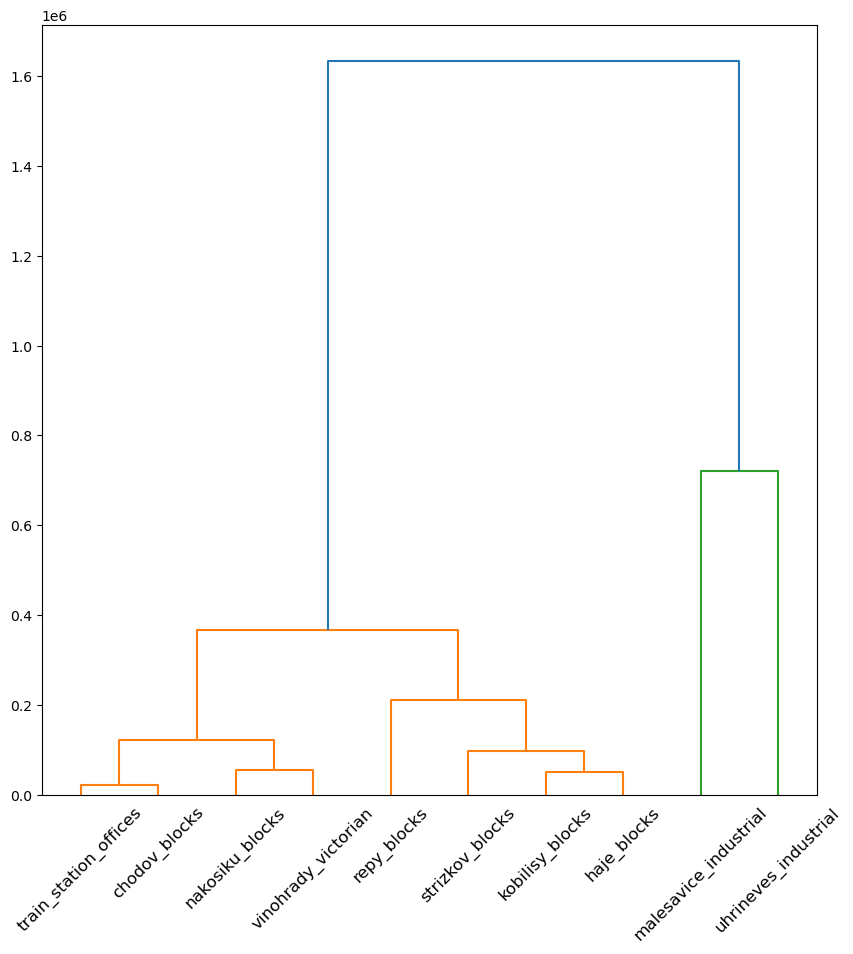

In [154]:

clusterer = AgglomerativeClustering(linkage=final_linkage,
                                    metric=final_metric,
                                    compute_full_tree=True,
                                    compute_distances=True)
model = clusterer.fit(component_data.loc[selected_morphotopes])
linkage_matrix = get_linkage_matrix(model)
fig,ax = plt.subplots(figsize=(10,10))
_ = dendrogram(linkage_matrix, ax=ax, labels=labels, leaf_rotation=45)

In [155]:
component_data.loc[selected_morphotopes].style.background_gradient(axis=0, cmap="BuGn")

,sdbAre,sdbPer,sdbCoA,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,mtbSWR,libNCo,ldbPWL,ltcBuA,mtbAli,mtbNDi,ltbIBD,stbSAl,sdsLen,sssLin,ldsMSL,ldsRea,ldsAre,sisBpM,sdsSPW,sdsSPO,sdsSWD,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,lddNDe,linWID,ldsCDL,xcnSCl,mtdMDi,sddAre,midRea,midAre,sdcLAL,sdcAre,sscCCo,sscERI,mtcWNe,mdcAre,ltcWRB,sicCAR,sdsAre,mibCou,mibAre,mibLen,mibElo,mibERI,mibCCo,mibLAL,mibFR,mibSCo,micBAD,licBAD,misBAD,midBAD
morph,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
69333_849_48,1563.076906,138.888897,3.159043,0.455068,8.204868,1.956980,0.945786,0.543324,21.762406,3.107385,0.084244,0.044625,225.040659,0.890196,3.170399,36.881263,39.277318,9.943542,606.634375,0.943036,355.991788,251.541582,1791884.524278,0.048192,42.037301,0.906828,2.552640,2.801217,0.072414,0.633839,0.161919,0.184400,0.000001,0.002783,0.005112,995.317645,0.025835,454.121172,154457.213385,44.338742,331055.843888,127.107330,7795.143677,0.458909,0.965086,0.025019,64381.555716,0.000010,0.161036,154994.229335,2.837728,3618.989368,228.368980,0.531898,0.904587,0.429482,76.383354,7.462817,7.462817,3573.099093,3961.954157,2755.789577,2887.734848
69333_849_43,756.892613,105.572450,0.000000,0.452666,6.091429,2.171356,0.967503,0.517942,17.956679,1.885277,0.060581,0.000000,127.340790,0.919087,2.163737,31.887418,39.890777,6.598687,986.757365,0.950621,365.836662,251.868571,1093008.580281,0.067257,36.999739,0.874122,6.101382,2.337143,0.048569,0.800405,0.084977,0.114619,0.000000,0.003462,0.006439,1311.491326,0.000000,823.526816,245149.985664,83.234286,418885.037162,96.428159,4179.837726,0.472761,0.967845,0.035365,40300.328417,0.000009,0.193993,273718.338168,1.365714,1028.496488,126.736822,0.546525,0.944096,0.451794,46.499281,5.426774,5.426774,1372.886661,1631.173511,1184.238525,1292.316154
69333_849_643,833.727927,125.480592,16.169009,0.447094,14.694215,10.040516,0.911455,0.559321,17.122829,4.186525,0.067445,0.123967,161.596990,0.786614,7.238983,47.264930,36.257403,10.443626,200.974182,0.907410,128.080478,116.578512,286131.762774,0.037442,29.261613,0.621376,4.015993,3.099174,0.162462,0.686481,0.260707,0.052812,0.000002,0.006229,0.013447,78.767363,0.035849,150.510959,25121.733349,18.479339,59481.711160,133.363522,7205.709974,0.429883,0.928256,0.027611,52815.773156,0.000045,0.143171,27698.864931,1.719008,1167.503235,167.170864,0.544385,0.866967,0.414872,55.604993,5.194792,5.194792,1322.051806,1711.150287,827.016511,593.565869
69333_849_647,932.350084,155.450087,1.481720,0.424616,6.739910,2.663316,0.905935,0.563276,18.106275,4.292659,0.012619,0.008969,160.861619,0.975674,5.958402,35.886324,39.391143,10.026035,246.430326,0.913039,183.153379,62.143498,442023.774742,0.031814,34.582030,0.695826,3.221096,2.668161,0.073281,0.655212,0.127937,0.202303,0.000001,0.005550,0.009498,300.548196,0.035028,180.422510,31363.125273,13.735426,78988.543771,126.973391,7082.118599,0.471006,0.960832,0.029763,52591.321056,0.000022,0.153623,30084.702188,1.080717,984.226547,160.686810,0.569150,0.897416,0.424190,59.280467,4.995517,4.995517,876.916228,1179.731597,602.149253,613.525659
69333_849_655,1102.198215,160.913463,9.871030,0.442694,6.843575,6.228429,0.878731,0.556067,16.868052,4.520239,0.004010,0.033520,163.041503,0.978811,5.397587,46.367164,45.086037,8.202800,209.566454,0.927450,159.917781,38.569832,300211.610483,0.019145,36.318441,0.722621,3.114903,2.832402,0.116609,0.656630,0.178017,0.165353,0.000001,0.005563,0.010252,266.317619,0.034938,170.246918,28223.783309,7.469274,62338.144652,154.399682,9716.584606,0.489932,0.957128,0.018569,68169.910990,0.000026,0.139651,30909.520453,1.044693,1157.585337,165.754386,0.561126,0.879269,0.445410,55.332148,6.044577,6.044577,1428.969294,2152.675470,696.253310,720.887502
69333_849_653,1592.785473,257.982498,25.007833,0.321077,12.339869,3.562532,0.811395,0.456316,25.284066,9.852877,0.016248,0.039216,268.767182,0.950571,4.049633,50.792758,45.358450,8.387005,277.407767,0.832849,156.665384,75.431373,381480.079934,0.023553,37.4760

## Normal Scalar

In [156]:
to_drop = ['stcSAl','stbOri','stcOri','stbCeA', 
           'ldkAre', 'ldkPer', 'lskCCo', 'lskERI',
           'lskCWA', 'ltkOri', 'ltkWNB', 'likWBB', 'likWCe',
          # 'licBAD', 'mibLAL', 'mibAre', 'mibLen', 'sscCCo'
          ]

component_data = morphotopes
component_data = component_data.drop(columns=to_drop)

In [157]:
from sklearn.preprocessing import StandardScaler, RobustScaler

vals = StandardScaler().fit_transform(component_data)
component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)
component_data = component_data.drop(component_data.columns[component_data.std() == 0], axis=1)

vals = np.nan_to_num(component_data)
component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)

# component_data = component_data.clip(-10, 10)

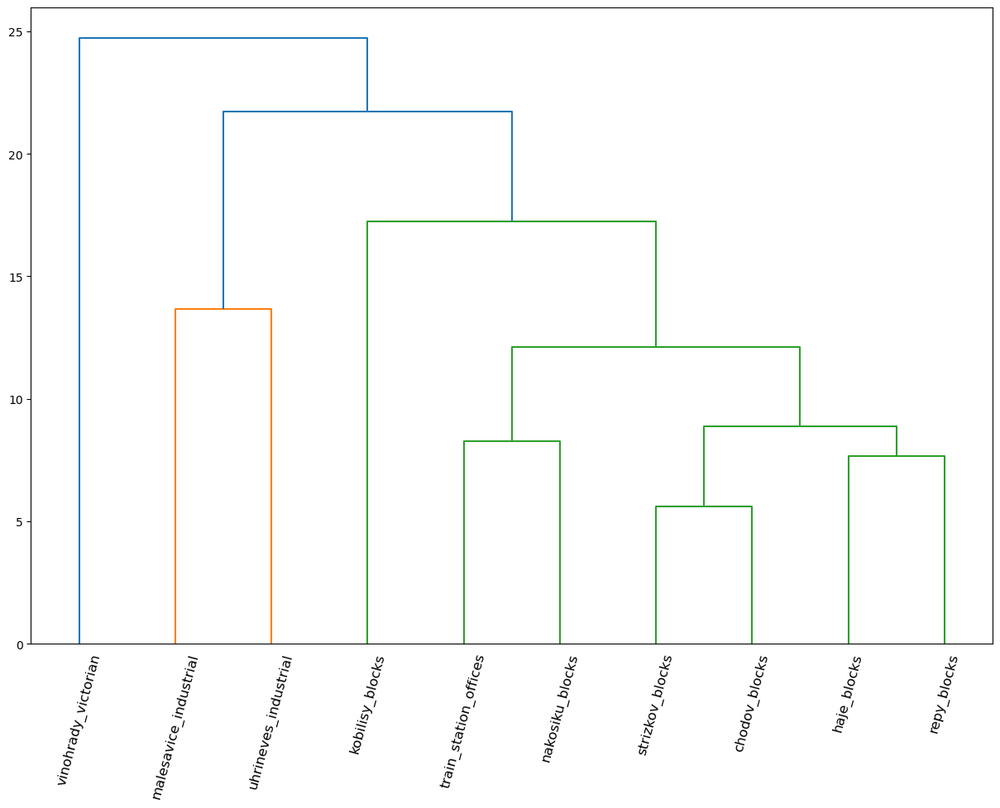

In [158]:
clusterer = AgglomerativeClustering(linkage=final_linkage,
                                    metric=final_metric,
                                    compute_full_tree=True,
                                    compute_distances=True)
model = clusterer.fit(component_data.loc[selected_morphotopes])
linkage_matrix = get_linkage_matrix(model)
fig,ax = plt.subplots(figsize=(15,10))
_ = dendrogram(linkage_matrix, ax=ax, labels=labels, leaf_rotation=75)

In [159]:
sel = component_data.loc[selected_morphotopes]
sel.index = labels
sel.style.background_gradient(axis=0, cmap="BuGn")

,sdbAre,sdbPer,sdbCoA,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,mtbSWR,libNCo,ldbPWL,ltcBuA,mtbAli,mtbNDi,ltbIBD,stbSAl,sdsLen,sssLin,ldsMSL,ldsRea,ldsAre,sisBpM,sdsSPW,sdsSPO,sdsSWD,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,lddNDe,linWID,ldsCDL,xcnSCl,mtdMDi,sddAre,midRea,midAre,sdcLAL,sdcAre,sscCCo,sscERI,mtcWNe,mdcAre,ltcWRB,sicCAR,sdsAre,mibCou,mibAre,mibLen,mibElo,mibERI,mibCCo,mibLAL,mibFR,mibSCo,micBAD,licBAD,misBAD,midBAD
malesavice_industrial,6.670050,3.932601,0.806917,-1.747350,0.733853,-0.328797,-0.021963,-1.895683,5.140923,2.582418,-0.005030,-0.057823,1.086189,-0.000043,-0.850059,1.674752,1.752405,0.324122,0.532962,0.175985,0.832161,0.524426,3.085615,-0.364303,3.492850,1.710237,-1.739661,-0.128983,-0.718995,-0.668729,0.318302,0.142879,-0.727916,-1.113891,-1.006162,1.371722,-0.189134,0.721140,1.045306,0.103813,2.278697,2.616054,3.486581,0.167160,0.158009,-1.418125,4.484902,-1.241868,0.310233,0.780306,0.083440,1.892230,0.564510,-1.100469,-0.061620,-0.820667,1.548724,4.100839,4.100839,8.940413,7.227508,8.586375,8.742094
uhrineves_industrial,2.809864,2.447763,-0.139299,-1.805521,-0.599218,-0.209196,0.886775,-2.216969,3.755359,0.941159,-0.189083,-0.090348,0.331488,0.205750,-1.337277,1.076759,1.827760,-0.469887,1.343162,0.279175,0.893762,0.527463,1.459570,-0.205925,2.382310,1.494811,1.668936,-1.097197,-1.163220,1.206179,-0.491655,-0.700791,-1.063262,-0.794717,-0.685289,2.066754,-0.868742,2.050351,1.996980,1.431313,3.119550,1.289475,1.264525,0.460706,0.359975,-0.850739,2.285765,-1.246067,0.708002,1.768919,-0.222642,0.331454,0.127420,-0.971070,0.333515,-0.544241,0.585742,2.280897,2.280897,3.138421,2.668974,3.410292,3.637959
train_station_offices,3.177768,3.335023,4.703743,-1.940424,4.827065,4.181019,-1.458573,-1.693184,3.451776,4.031673,-0.135694,0.000006,0.596107,-0.737864,1.119111,2.918152,1.381448,0.442833,-0.331668,-0.308636,-0.593922,-0.728902,-0.417757,-0.453614,0.676425,-0.169956,-0.334098,0.492654,0.958608,-0.076179,1.358222,-1.448046,0.922103,0.506161,1.008619,-0.643095,0.074280,-0.371323,-0.311860,-0.778765,-0.321279,2.886574,3.124300,-0.447913,-2.538285,-1.275966,3.428696,-0.571852,0.094621,-0.279679,-0.149180,0.415205,0.301315,-0.990003,-0.437859,-1.001657,0.879164,2.073537,2.073537,3.004369,2.825392,2.233740,1.402486
strizkov_blocks,3.649993,4.670695,0.304515,-2.484670,-0.190182,0.065269,-1.689580,-1.643121,3.809823,4.174209,-0.562143,-0.083811,0.590426,0.608830,0.499318,1.555612,1.766387,0.343704,-0.234782,-0.232064,-0.249320,-1.234410,-0.055049,-0.500374,1.849321,0.320424,-1.097603,-0.406581,-0.702843,-0.428152,-0.039419,0.359323,-0.143333,0.186908,0.054059,-0.155563,0.052697,-0.263694,-0.246366,-0.940674,-0.134526,2.610262,3.048338,0.423514,-0.153451,-1.157978,3.408198,-1.003525,0.220769,-0.259812,-0.281902,0.304781,0.273429,-0.770910,-0.133332,-0.886222,0.997602,1.895412,1.895412,1.830540,1.786045,1.493114,1.466343
chodov_blocks,4.463263,4.914185,2.817333,-2.046949,-0.124795,2.054251,-2.827927,-1.734383,3.359019,4.479842,-0.629101,-0.065917,0.607265,0.631174,0.227887,2.810648,2.465930,-0.089099,-0.313355,-0.036024,-0.394710,-1.453326,-0.384998,-0.605617,2.232116,0.496918,-1.199603,-0.063920,0.104361,-0.412183,0.487759,-0.087410,0.084292,0.193017,0.236373,-0.230811,0.050328,-0.300309,-0.279309,-1.154537,-0.293932,3.796185,4.667545,0.824578,-0.424587,-1.771872,4.830860,-0.925142,0.052134,-0.252944,-0.289393,0.409230,0.295223,-0.841894,-0.314822,-0.623331,0.870372,2.833128,2.833128,3.286312,3.688926,1.803056,1.809819
kobilisy_blocks,6.812301,9.240329,7.351203,-4.991572,3.342041,0.566943,-5.645669,-2.997034,6.423066,11.641432,-0.533916,-0.061766,1.423963,0.430019,-0.424515,3.340595,2.499393,-0.045372,-0.168756,-1.322893,-0.415061,-1.111013,-0.195914,-0.568997,2.487321,0.490385,-1.865160,0.203928,0.022700,-1.099148,1.062452,-0.010637,0.456291,0.864476,0.601440,-0.360224,-0.567376,-0.180126,-0.086686,-0.985404,-0.004950,4.928658,6.329109,-0.076886,-1.514916,-1.725197,6.361517,-0.957103,0.209602,-0.144081,

## Robust scalar

In [33]:
from sklearn.preprocessing import StandardScaler, RobustScaler
component_data = morphotopes

vals = RobustScaler( quantile_range=(25.0, 75.0),).fit_transform(component_data)
component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)
component_data = component_data.drop(component_data.columns[component_data.std() == 0], axis=1)

# component_data = component_data[component_data.index >= 0]
vals = np.nan_to_num(component_data)
component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)

In [34]:
component_data.loc[selected_morphotopes].style.background_gradient(axis=0, cmap="BuGn")

,sdbAre,sdbPer,sdbCoA,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,mtbSWR,libNCo,ldbPWL,ltcBuA,mtbAli,mtbNDi,ltbIBD,stbCeA,stbSAl,sdsLen,sssLin,ldsMSL,ldsRea,ldsAre,sisBpM,sdsSPW,sdsSPO,sdsSWD,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,lddNDe,linWID,ldsCDL,xcnSCl,mtdMDi,sddAre,midRea,midAre,stcOri,sdcLAL,sdcAre,sscCCo,sscERI,mtcWNe,mdcAre,ltcWRB,sicCAR,stcSAl,ldkAre,ldkPer,lskCCo,lskERI,lskCWA,ltkOri,ltkWNB,likWBB,sdsAre,likWCe,mibCou,mibAre,mibLen,mibElo,mibERI,mibCCo,mibLAL,mibFR,mibSCo,micBAD,licBAD,misBAD,midBAD
morph,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
69333_849_48,22.730062,6.905312,3.159043,-1.433790,0.874677,-0.097874,-0.132577,-1.541079,7.106460,3.571170,-0.934318,0.612607,0.044625,6.116921,-0.472239,-0.596102,1.485528,1.591651,-0.009239,0.262796,1.975359,-0.106981,1.430163,0.795406,4.498189,-0.760652,3.109446,1.346923,-1.365331,-0.279642,-0.441476,-0.605401,0.472579,0.142299,-0.403164,-0.827984,-0.671467,2.430997,0.057988,2.053361,3.883026,0.454647,4.533513,-1.127395,2.231849,3.553865,0.006764,0.113999,-1.225283,5.319236,-0.857522,0.539989,0.549902,2.451702,0.930620,0.683653,-0.014318,0.741285,-0.785407,-0.525090,1.466230,3.555657,-0.883178,2.735990,24.891204,6.183015,-1.054231,-0.645786,-0.933458,5.759272,7.969703,7.969703,36.600296,23.472264,33.557490,33.303760
69333_849_43,10.026359,4.419363,0.000000,-1.476501,-0.386737,0.030269,0.748369,-1.777042,5.267169,1.440094,1.699312,0.321841,0.000000,2.558775,-0.213277,-0.933623,0.997144,1.655976,-0.008330,-0.328762,3.862828,0.002608,1.501771,0.798700,2.378043,-0.170085,2.142045,1.172016,1.176774,-1.317993,-0.781558,0.918425,-0.230210,-0.483636,-0.633789,-0.611734,-0.462405,3.472925,-0.423494,4.657839,6.552958,2.210663,5.979367,1.610382,1.174081,1.445290,0.332512,0.287826,-0.698036,2.840375,-0.861146,0.976715,-0.166187,4.504477,2.509438,-0.326048,-1.071734,2.289863,1.380828,-0.622691,0.829830,6.760830,-0.726859,0.250707,6.233573,2.529586,-0.949126,0.194917,-0.689033,2.704331,4.628281,4.628281,13.516793,9.223980,13.860264,14.365282
69333_849_640,7.204535,4.494826,16.889140,-1.385122,1.814885,1.775963,-2.649915,-0.581456,2.523415,3.701847,0.083273,0.129532,0.014184,2.372403,-0.276292,0.145651,1.057340,0.846849,0.498830,0.668685,0.301722,-1.067039,-0.104382,-0.892945,-0.262863,-0.668924,1.159445,0.050645,-0.059284,-1.326517,-0.439557,-0.611050,0.016955,0.773257,-0.048972,0.479909,0.224977,0.452203,-0.116574,0.382682,0.267931,-0.662104,-0.099362,0.151271,1.787417,2.157636,-0.798368,-1.358560,-0.925089,2.270759,-0.560999,0.071324,0.308376,1.935273,2.037377,-0.586405,-1.141002,1.487135,-0.224572,-0.330017,0.048465,0.485817,-0.729423,0.351700,3.491496,2.444225,-0.371105,-1.895417,-0.809396,2.085224,2.003485,2.003485,5.958180,3.893003,4.283053,4.100593
69333_849_660,15.699176,10.424211,24.541441,-2.659267,0.823549,0.112110,-3.599597,-2.139924,5.138853,7.661334,-0.376580,-0.314567,0.099338,5.058308,0.195568,-0.942900,1.887367,2.616562,-0.632412,-0.284634,0.026996,-1.035751,0.016057,-1.270328,0.117619,-1.695749,2.092913,0.240994,-1.235045,0.194764,-0.471113,-0.631310,0.646280,0.175096,0.297901,0.135629,0.179474,0.187605,0.134211,-0.009116,0.102500,-1.187133,0.121936,-0.442707,2.537319,3.326836,0.845890,0.336309,-1.461271,5.452839,-0.657772,0.513928,-0.378938,0.893951,0.551870,0.667688,0.109340,0.343501,0.023057,-0.058228,0.630344,0.058280,-0.892422,-0.154307,7.760545,5.202385,-1.506960,-1.620503,-1.533525,5.273114,5.429975,5.429975,11.751663,7.498719,8.388379,5.911410
69333_849_266,14.915114,8.854716,24.749294,-2.200642,0.186961,0.465240,-3.235299,-1.385757,4.680848,5.717630,-0.915483,-0.233177,0.090909,4.061058,0.092515,-0.251592,2.957476,2.642890,0.548193,0.450226,0.655189,-0.654571,0.277503,-0.766107,0.728626,-1.586430,2.237341,0.750774,-1.134148,0.133012,0.233708,0.656884,-0.029400,-0.424406,0.124420,-0.220598,-0.133922,-0.443652,-0.157101,0.570062,0.952784,-0.780262,0.873198,-0.629425,3.183147,4.598867,0.244053,-1.047810,-1.4811

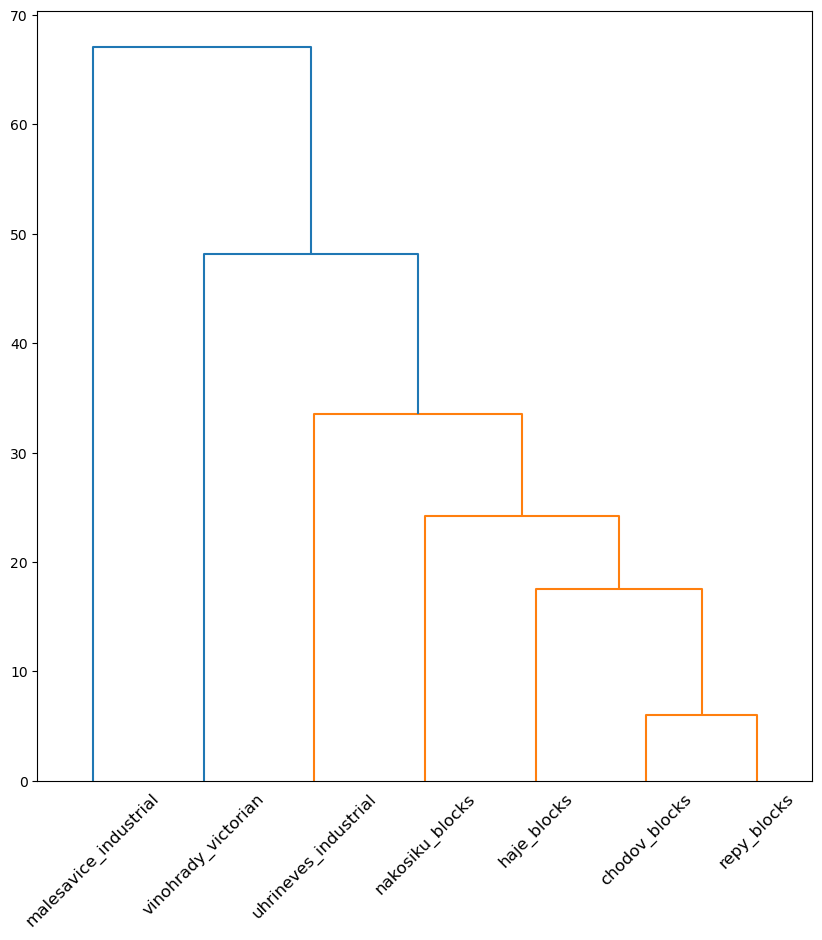

In [35]:
clusterer = AgglomerativeClustering(linkage=final_linkage,
                                    metric=final_metric,
                                    compute_full_tree=True,
                                    compute_distances=True)
model = clusterer.fit(component_data.loc[selected_morphotopes])
linkage_matrix = get_linkage_matrix(model)
fig,ax = plt.subplots(figsize=(10,10))
_ = dendrogram(linkage_matrix, ax=ax, labels=labels, leaf_rotation=45)

## knns

In [50]:
from sklearn.neighbors import KDTree
sklearn_tree = KDTree(component_data)

In [56]:
# kamyk
dists, indxs = sklearn_tree.query(component_data.loc[['69333_849_506']], k=30)

knns = component_data.iloc[indxs[0][1:]]
knns = pd.Series(knns.index)

plotting = etcs[etcs.morph.isin(knns)]
plotting['ranking'] = plotting.morph.map(dict(zip(knns.values, knns.index)))
plotting.shape

/home/krasen/urban_taxonomy/.pixi/envs/default/lib/python3.12/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


(4259, 5)

In [57]:

dists

array([[0.        , 3.95943773, 4.4329681 , 4.51082116, 4.94507018,
        5.12132099, 5.32973571, 5.37870595, 5.60416261, 5.68263168,
        5.68661977, 5.68834699, 6.53205655, 6.67641523, 6.87127249,
        6.88820287, 6.93454144, 7.05295927, 7.23038667, 7.2911812 ,
        7.3704303 , 7.4584531 , 7.77603739, 7.97998662, 8.15651626,
        8.22745883, 8.27024187, 8.33557032, 8.5101473 , 8.5747474 ]])

In [58]:
plotting.explore(prefer_canvas=True, tiles='cartodb positron')

In [59]:
### haje / chodv
dists, indxs = sklearn_tree.query(component_data.loc[['69333_849_660']], k=30)

knns = component_data.iloc[indxs[0][1:]]
knns = pd.Series(knns.index)

plotting = etcs[etcs.morph.isin(knns)]
plotting['ranking'] = plotting.morph.map(dict(zip(knns.values, knns.index)))
plotting.shape

/home/krasen/urban_taxonomy/.pixi/envs/default/lib/python3.12/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


(4319, 5)

In [60]:
dists

array([[0.        , 4.82682567, 5.71371717, 5.87094233, 6.01347729,
        6.61713578, 6.67192327, 6.88820287, 6.92474299, 6.93370526,
        7.2798128 , 7.32008322, 7.37250338, 7.77971953, 8.08875517,
        8.30019196, 8.53647041, 8.54305628, 8.57615113, 8.57907403,
        9.25344266, 9.35232875, 9.38432682, 9.43646347, 9.46732937,
        9.51087724, 9.52145376, 9.62458034, 9.79161721, 9.80414394]])

In [61]:
plotting.explore(prefer_canvas=True, tiles='cartodb positron')

## variance in morphotopes

In [62]:
to_drop = ['stcSAl','stbOri','stcOri','stbCeA', 
           'ldkAre', 'ldkPer', 'lskCCo', 'lskERI',
           'lskCWA', 'ltkOri', 'ltkWNB', 'likWBB', 'likWCe',
          # 'licBAD', 'mibLAL', 'mibAre', 'mibLen', 'sscCCo'
          ]

component_data = primary.drop(columns=to_drop)
component_data = component_data[component_data.index >= 0]

etcs_morphs = component_data.iloc[:,-1]
component_data = component_data.iloc[:, :-1]

In [63]:
from sklearn.preprocessing import StandardScaler

vals = StandardScaler().fit_transform(component_data)
component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)
component_data = component_data.drop(component_data.columns[component_data.std() == 0], axis=1)

vals = np.nan_to_num(component_data)
component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)

In [73]:
def describe_distances(group):
    
    if group.shape[0] < 3:
        return pd.Series([1]).describe()
        
    clusterer = AgglomerativeClustering(linkage='complete',
                                    metric='euclidean',
                                    compute_full_tree=True,
                                    compute_distances=True)
    model = clusterer.fit(group.values)
    linkage_matrix = get_linkage_matrix(model)
    return pd.Series(linkage_matrix[:, 2]).describe()

res = component_data.groupby(etcs_morphs).apply(describe_distances)

In [82]:
res = res[res['mean'] > 1]

In [76]:
sel = res.loc[selected_morphotopes]
sel.index = labels

In [77]:
sel

,count,mean,std,min,25%,50%,75%,max
malesavice_industrial,492.0,8.780168,7.484417,0.020623,4.613515,6.945404,10.594641,84.336818
uhrineves_industrial,174.0,6.335995,5.562082,1.386397,3.401047,5.018604,7.186323,51.009909
nakosiku_blocks,140.0,6.942553,5.743405,1.556425,4.159058,5.706980,7.748441,55.408417
chodov_blocks,178.0,7.907424,5.300896,1.701404,4.819952,6.728167,9.329470,49.257525
repy_blocks,208.0,7.164276,5.274588,0.457427,4.211262,5.841261,8.293545,51.132289
haje_blocks,107.0,8.025246,4.823303,1.700467,5.219625,6.905379,9.384213,35.377458
vinohrady_victorian,87.0,4.866501,3.118839,1.496561,2.822751,4.179824,5.710507,20.764913
train_station_offices,120.0,9.875513,7.085778,0.190304,5.820591,8.136190,11.388870,44.158471


In [90]:
etcs[etcs.morph.isin(res[res['50%'] > 8].index)].explore()